# Library

In [1]:
import os
import random
from PIL import Image
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from collections import defaultdict
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from matplotlib import font_manager as fm


from cldm.config import EXP_FOLDER_TEST, SIM_FOLDER_TEST, MAIN_FOLDER,OUTPUT_DIR_CONTRASTIVE_LEARNING
from cldm.config import FPATH
from cldm.preprocess import preprocess_experimental_backgroundwhite_blackandwhite,preprocess_experimental_backgroundwhite, preprocess_simulation_graybackground, preprocess_simulation, preprocess_experimental_backgroundblack_blackandwhite, preprocess_experimental_backgroundblack_blackandwhite_nocropping


In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [3]:
prop = fm.FontProperties(fname=str(FPATH),size=30)

# Data

For experiments and predictions, we use the versions used in the paper for testing the trained contrastive model (trained on simulation images used in the paper). Black and white versions (thresholded) are directly from these images. 

For testing the dissimilarity between exp-prediction and exp-simulation pairs, we try to make a fair comparision, and make the background of all the images (simulations, predictions and experiments) black and the patterns themselves in white. 

Appropriate preprocessing functions are used in the respective code blocks.

In [4]:
# dataset

path_1 = EXP_FOLDER_TEST    # <Experiments processed BnW> color now, to process later 
path_2 = EXP_FOLDER_TEST    # <Experiments processed color> to process later to add white background

path_4 = MAIN_FOLDER     # <Predictions color> 
path_5 = SIM_FOLDER_TEST # Simulations, currently black and white
path_6 = MAIN_FOLDER    # Predictions BnW, to process to make black and white

# filename: ExpID_RepID.png
alldata_exp = [os.path.join(path_1, f) for f in os.listdir(path_1) if f.endswith(".TIF")]
alldata_exp_color = [os.path.join(path_2, f) for f in os.listdir(path_2) if f.endswith(".TIF")]
alldata_pred_color = [os.path.join(path_4, f) for f in os.listdir(path_4) if f.endswith(".png")]
alldata_sim = [os.path.join(path_5, f) for f in os.listdir(path_5) if f.endswith(".TIF")]
alldata_pred = [os.path.join(path_6, f) for f in os.listdir(path_6) if f.endswith(".png")]

print(len(alldata_sim))
print(len(alldata_pred))
print(len(alldata_pred_color))
print(len(alldata_exp))
print(len(alldata_exp_color))

96
96
96
96
96


# Dataset

In [5]:
# Dataset for training siamese network
class SiamesePairsDataset(Dataset):
    def __init__(self, pairs, labels, transform=None, preprocess_func=None):
        self.pairs = pairs
        self.labels = labels # binary
        self.transform = transform
        self.preprocess_func = preprocess_func

    def __len__(self):
        return len(self.pairs)

    def __getitem__(self, idx):
        f1, f2 = self.pairs[idx]

        if self.preprocess_func:
            img1 = self.preprocess_func(f1)
            img2 = self.preprocess_func(f2)
            img1= Image.fromarray(img1).convert("L")
            img2= Image.fromarray(img2).convert("L")
        else:
            img1 = Image.open(f1).convert("L")
            img2 = Image.open(f2).convert("L")
            
        if self.transform:
            img1 = self.transform(img1)
            img2 = self.transform(img2)
        return img1, img2, torch.tensor(self.labels[idx], dtype=torch.float32)

# Generate balanced image pairs
def generate_pairs(alldata_sim, seed=42):
    random.seed(seed)
    group = defaultdict(list)
    for f in alldata_sim:
        expid = os.path.basename(f).split('_')[0]
        group[expid].append(f)

    # 1. Identical pairs -- replicates from the same experiments
    positive_pairs = []
    valid_expids = []
    for expid, files in group.items():
        if len(files) == 2:
            f1, f2 = files
            positive_pairs.append((f1, f2))
            valid_expids.append(expid)
        else:
            print(f"Skipping {expid}: {len(files)} replicates")

    # 2. Dissimilar pairs -- from different experiments
    negative_pairs = set()
    while len(negative_pairs) < len(positive_pairs):
        e1, e2 = random.sample(valid_expids, 2)
        f1 = random.choice(group[e1])
        f2 = random.choice(group[e2])
        pair = tuple(sorted((f1, f2)))
        negative_pairs.add(pair)

    negative_pairs = list(negative_pairs)

    # Combine
    all_pairs = positive_pairs + negative_pairs
    all_labels = [1] * len(positive_pairs) + [0] * len(negative_pairs)

    return all_pairs, all_labels

In [6]:
# Generate training data and split
all_pairs, all_labels = generate_pairs(alldata_sim) # use binary simulation image pairs
split_ratio = 0.2
train_pairs, test_pairs, train_labels, test_labels = train_test_split(all_pairs, all_labels, test_size=split_ratio, random_state=42, stratify=all_labels)

# transform
transform = transforms.Compose([transforms.Resize((224, 224)), transforms.ToTensor()])

# create datasets and dataloaders  # training with gray background simulations used in the paper
train_dataset = SiamesePairsDataset(train_pairs, train_labels, transform=transform, preprocess_func=preprocess_simulation_graybackground)
test_dataset = SiamesePairsDataset(test_pairs, test_labels, transform=transform, preprocess_func=preprocess_simulation_graybackground)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

print(f"Total pairs: {len(all_pairs)} (Train: {len(train_dataset)}, Test: {len(test_dataset)})")

Total pairs: 96 (Train: 76, Test: 20)


# Train

In [7]:
class SiameseNet(nn.Module):
    def __init__(self):
        super(SiameseNet, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(1, 16, 3), nn.ReLU(), nn.MaxPool2d(2),
            nn.Conv2d(16, 32, 3), nn.ReLU(), nn.MaxPool2d(2),
        )
        self.fc = nn.Sequential(
            nn.Linear(32 * 54 * 54, 128),
            nn.ReLU(),
            nn.Linear(128, 64)
        )

    def forward_once(self, x):
        x = self.conv(x)
        x = x.view(x.size(0), -1)
        return self.fc(x)

    def forward(self, x1, x2):
        out1 = self.forward_once(x1)
        out2 = self.forward_once(x2)
        return out1, out2

def contrastive_loss(out1, out2, label, margin=1.0):
    d = F.pairwise_distance(out1, out2)
    loss = torch.mean(label * torch.pow(d, 2) + (1 - label) * torch.pow(torch.clamp(margin - d, min=0.0), 2))
    return loss


In [7]:
model = SiameseNet().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
epochs = 10
patience = 10  # early stopping
min_delta = 1e-4  # early stopping

best_test_loss = float('inf')
early_stop_counter = 0

for epoch in range(1, epochs + 1):
    # Train
    model.train()
    total_train_loss = 0
    for img1, img2, label in train_loader:
        img1, img2, label = img1.to(device), img2.to(device), label.to(device)
        out1, out2 = model(img1, img2)
        loss = contrastive_loss(out1, out2, label)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        total_train_loss += loss.item()

    avg_train_loss = total_train_loss / len(train_loader)

    # Validate
    model.eval()
    total_test_loss = 0
    with torch.no_grad():
        for img1, img2, label in test_loader:
            img1, img2, label = img1.to(device), img2.to(device), label.to(device)
            out1, out2 = model(img1, img2)
            loss = contrastive_loss(out1, out2, label)
            total_test_loss += loss.item()

    avg_test_loss = total_test_loss / len(test_loader)
    print(f"Epoch {epoch} | Train Loss: {avg_train_loss:.4f}, Test Loss: {avg_test_loss:.4f}")

    # Early stopping
    if avg_test_loss + min_delta < best_test_loss:
        best_test_loss = avg_test_loss
        early_stop_counter = 0
        torch.save(model.state_dict(), "best_model.pth")  # save best model
    else:
        early_stop_counter += 1
        if early_stop_counter >= patience:
            print(f"Early stopping.")
            break

Epoch 1 | Train Loss: 0.1546, Test Loss: 0.0000
Epoch 2 | Train Loss: 0.0000, Test Loss: 0.0000
Epoch 3 | Train Loss: 0.0000, Test Loss: 0.0000
Epoch 4 | Train Loss: 0.0000, Test Loss: 0.0000
Epoch 5 | Train Loss: 0.0000, Test Loss: 0.0000
Epoch 6 | Train Loss: 0.0000, Test Loss: 0.0000
Epoch 7 | Train Loss: 0.0000, Test Loss: 0.0000
Epoch 8 | Train Loss: 0.0000, Test Loss: 0.0000
Epoch 9 | Train Loss: 0.0000, Test Loss: 0.0000
Epoch 10 | Train Loss: 0.0000, Test Loss: 0.0000


In [8]:
model_dir = OUTPUT_DIR_CONTRASTIVE_LEARNING
os.makedirs(model_dir, exist_ok=True)
model_path = os.path.join(model_dir, "model.pth")
torch.save(model, model_path)
print(f"Model saved to {model_path}")

Model saved to /hpc/dctrl/ks723/Physics_constrained_DL_pattern_prediction/sim_to_exp_diffusion/controlnet_essential/contrastive_learning_v20251114_1234/model.pth


In [9]:
# or load from model checkpoint 
model_dir= '/hpc/dctrl/ks723/Physics_constrained_DL_pattern_prediction/sim_to_exp_diffusion/controlnet_essential/contrastive_learning_v20251114_1234'
model = SiameseNet().to(device)
model_path=os.path.join(model_dir, "model.pth")
model = torch.load(model_path)

# Scoring

In [10]:
def plot_test_pairs(model, data_loader, device, num_pairs=5):
    model.eval()
    shown = 0

    with torch.no_grad():
        for img1, img2, label in data_loader:
            img1, img2 = img1.to(device), img2.to(device)
            out1, out2 = model(img1, img2)
            distances = F.pairwise_distance(out1, out2).cpu().numpy()
            labels = label.numpy()
            imgs1 = img1.cpu()
            imgs2 = img2.cpu()

            for i in range(len(distances)):
                if shown >= num_pairs:
                    return
                fig, axs = plt.subplots(1, 2, figsize=(4, 2))
                axs[0].imshow(imgs1[i][0], cmap='gray')
                axs[0].set_title("Image 1")
                axs[0].axis('off')
                axs[1].imshow(imgs2[i][0], cmap='gray')
                axs[1].set_title("Image 2")
                axs[1].axis('off')
                if int(labels[i]) == 1:
                  label = "Identical"
                elif int(labels[i]) == 0:
                  label = "Different"
                plt.suptitle(f"Label: {label}, Dissimilarity: {distances[i]:.4f}")
                plt.tight_layout()
                plt.show()
                shown += 1


## Test set

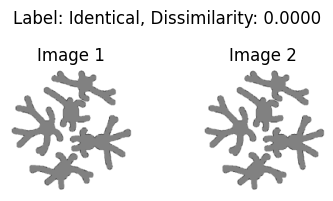

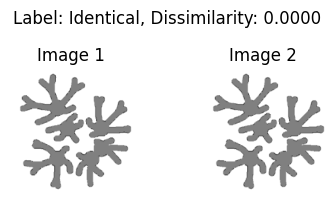

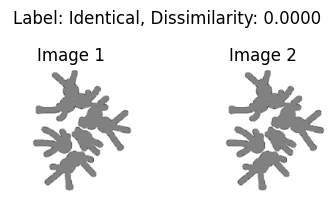

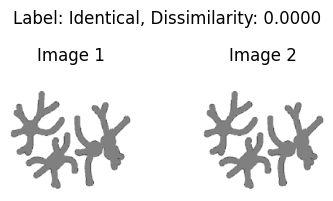

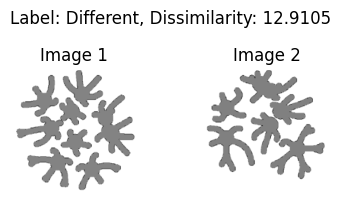

...

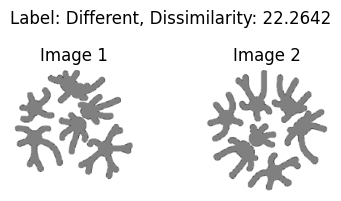

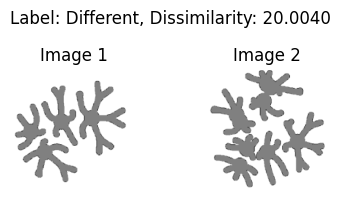

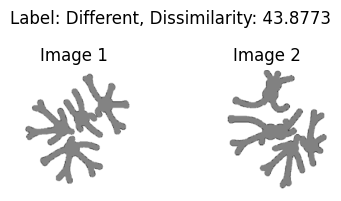

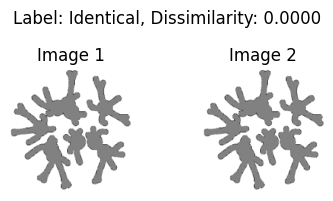

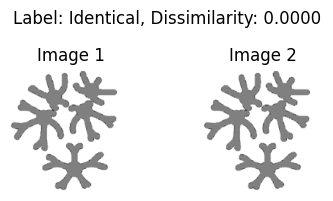

In [11]:
# Plot dissimilarity scores on test sets
plot_test_pairs(model, test_loader, device, num_pairs=len(test_loader.dataset.pairs))

## Experiment set

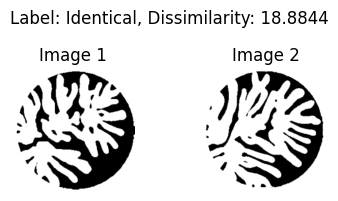

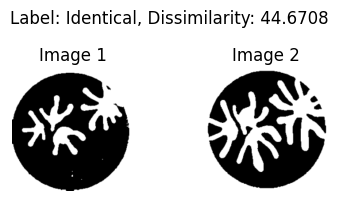

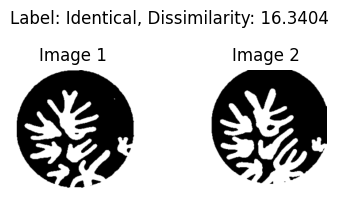

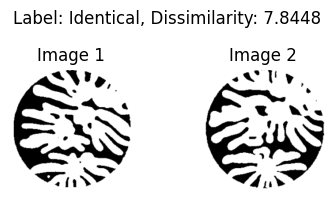

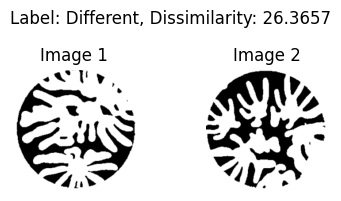

...

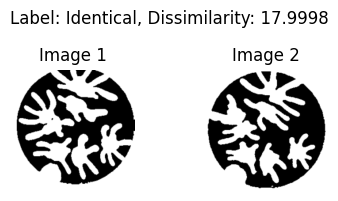

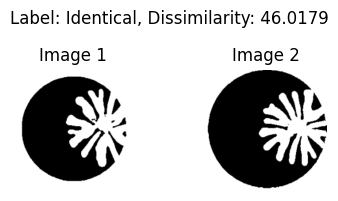

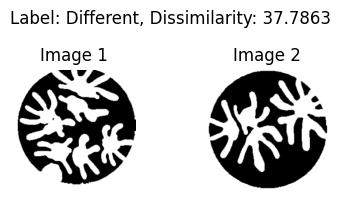

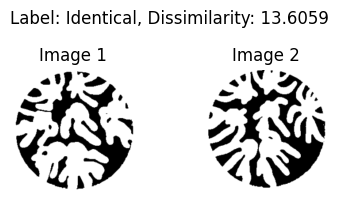

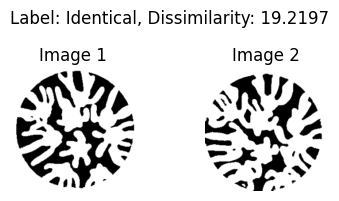

In [12]:
# Now use the trained model on image pairs from different sources

# Generate balanced pairs from experimental data
exp_pairs, exp_labels = generate_pairs(alldata_exp, seed=0)

# Create Dataset and DataLoader
exp_dataset = SiamesePairsDataset(exp_pairs, exp_labels, transform=transform, preprocess_func=preprocess_experimental_backgroundwhite_blackandwhite)
exp_loader = DataLoader(exp_dataset, batch_size=32, shuffle=True)

# Plot results

plot_test_pairs(model, exp_loader, device, num_pairs=len(exp_loader.dataset.pairs))


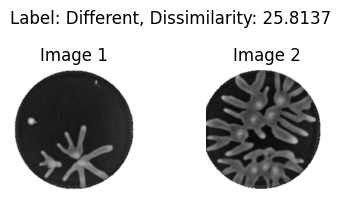

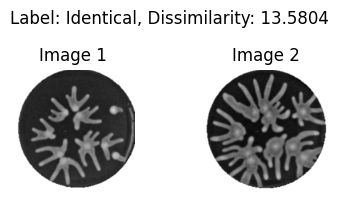

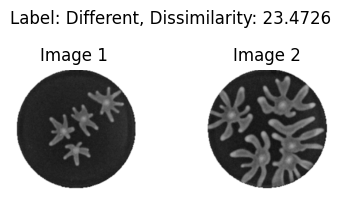

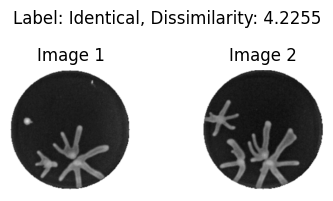

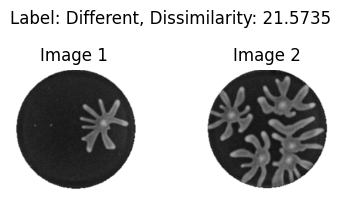

...

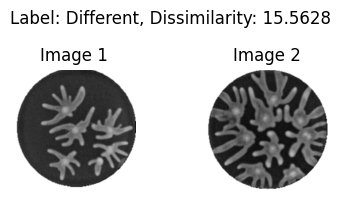

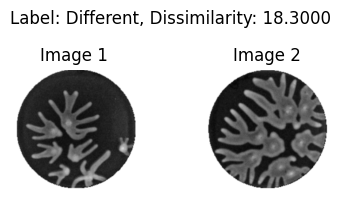

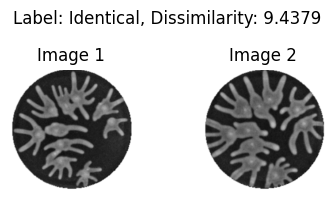

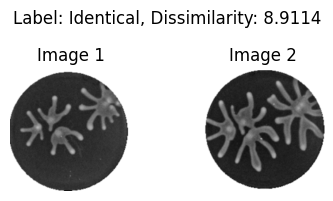

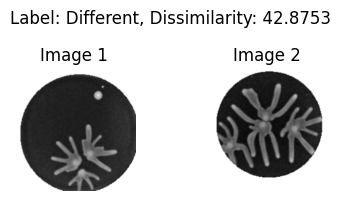

In [13]:
# On grayscale experimental images

# Generate balanced pairs from experimental data
exp_pairs_color, exp_labels_color = generate_pairs(alldata_exp_color, seed=0)

# Create Dataset and DataLoader
exp_dataset_color  = SiamesePairsDataset(exp_pairs_color, exp_labels_color , transform=transform,preprocess_func=preprocess_experimental_backgroundwhite)
exp_loader_color = DataLoader(exp_dataset_color , batch_size=32, shuffle=True)

# Plot results
plot_test_pairs(model, exp_loader_color, device, num_pairs=len(exp_loader_color.dataset.pairs))


## Simulation set

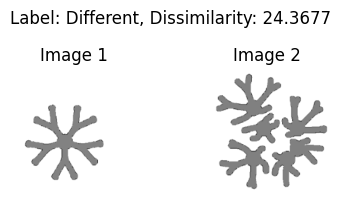

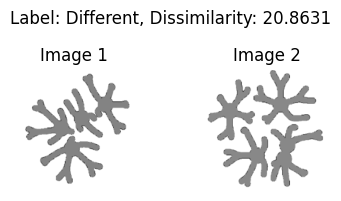

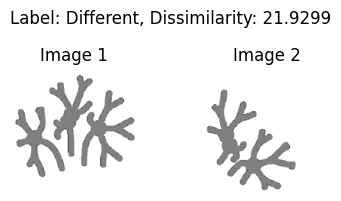

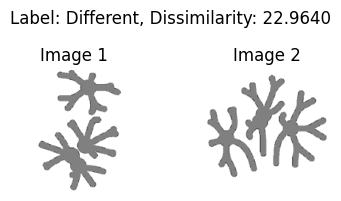

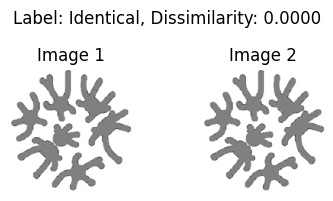

...

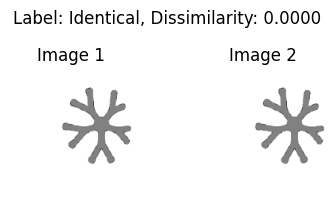

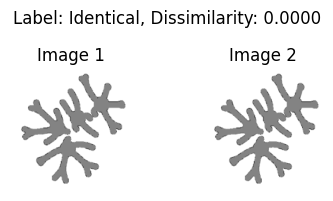

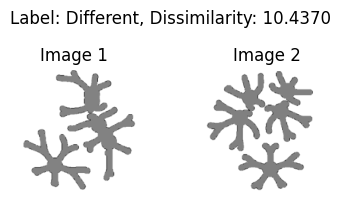

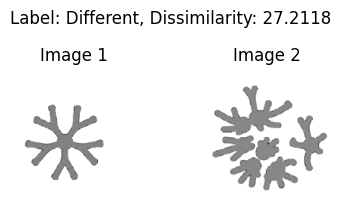

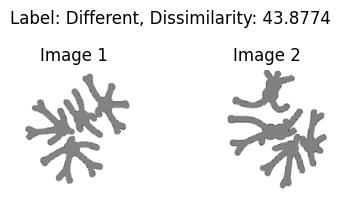

In [14]:
# Generate balanced pairs from simulation data
sim_pairs, sim_labels = generate_pairs(alldata_sim, seed=0)


# Create Dataset and DataLoader
sim_dataset  = SiamesePairsDataset(sim_pairs, sim_labels , transform=transform, preprocess_func=preprocess_simulation_graybackground)
sim_loader = DataLoader(sim_dataset , batch_size=32, shuffle=True)

# Plot results

plot_test_pairs(model, sim_loader, device, num_pairs=len(sim_loader.dataset.pairs))


## Prediction set

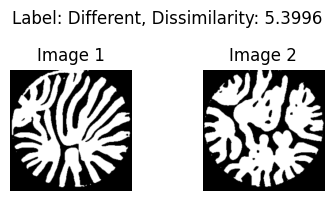

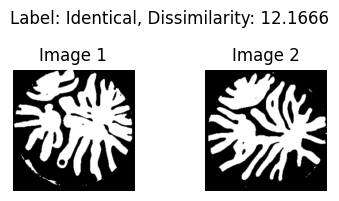

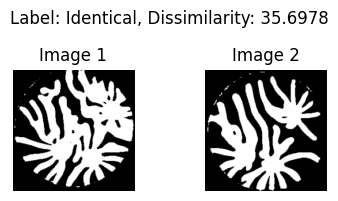

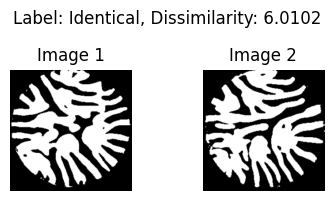

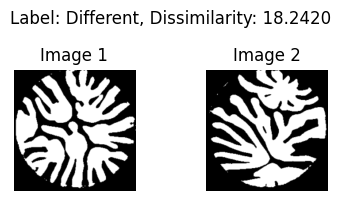

...

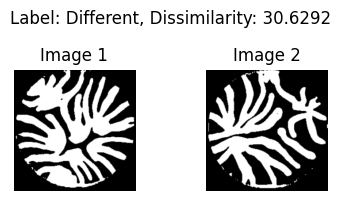

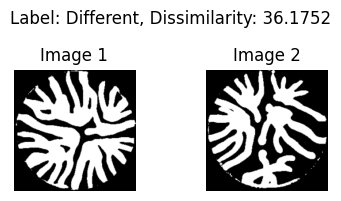

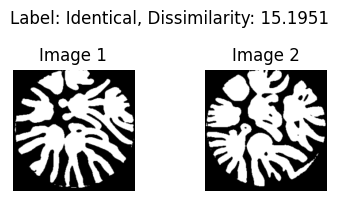

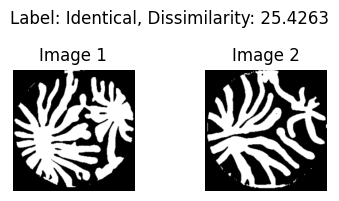

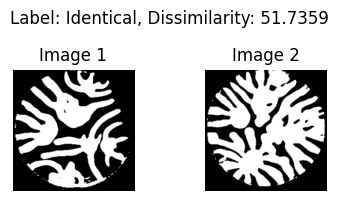

In [15]:
# Generate balanced pairs from prediction data
pred_pairs, pred_labels = generate_pairs(alldata_pred, seed=0)

# Create Dataset and DataLoader
pred_dataset = SiamesePairsDataset(pred_pairs, pred_labels, transform=transform, preprocess_func=preprocess_experimental_backgroundblack_blackandwhite_nocropping)
pred_loader = DataLoader(pred_dataset, batch_size=32, shuffle=True)

# Plot results
plot_test_pairs(model, pred_loader, device, num_pairs=len(pred_loader.dataset.pairs))


Prediction grayscale


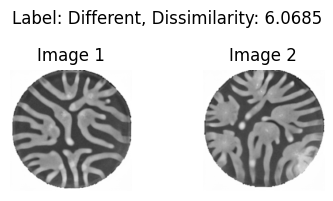

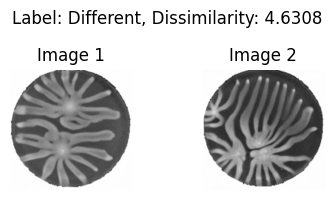

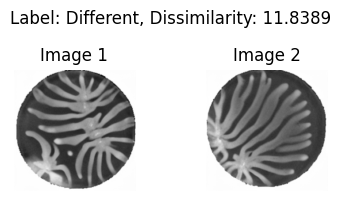

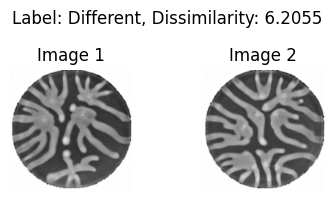

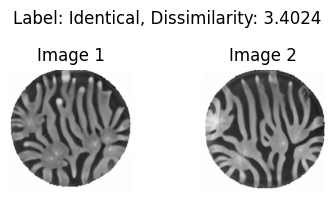

...

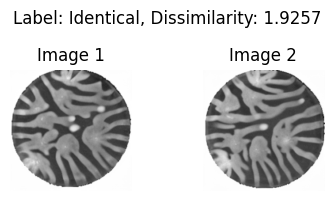

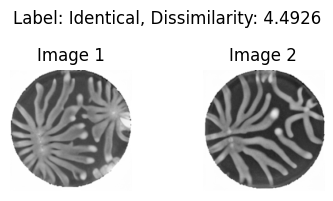

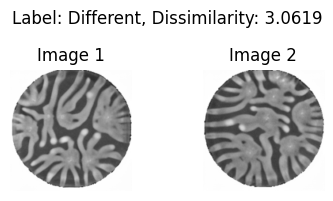

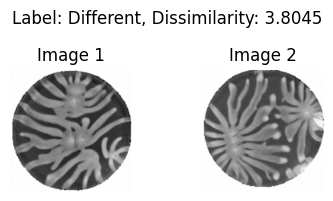

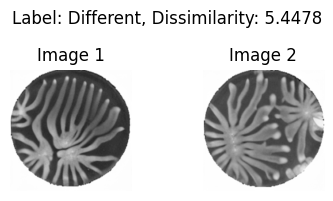

In [16]:
# Generate balanced pairs from prediction data
pred_pairs_color, pred_labels_color = generate_pairs(alldata_pred_color, seed=0)

# Create Dataset and DataLoader
pred_dataset_color = SiamesePairsDataset(pred_pairs_color, pred_labels_color, transform=transform, preprocess_func=None)
pred_loader_color = DataLoader(pred_dataset_color, batch_size=32, shuffle=True)

# Plot results
plot_test_pairs(model, pred_loader_color, device, num_pairs=len(pred_loader_color.dataset.pairs))



# Score histograms

In [17]:
def get_scores_by_label(model, loader, device):
    model.eval()
    scores_label_0 = []
    scores_label_1 = []

    with torch.no_grad():
        for img1, img2, label in loader:
            img1, img2, label = img1.to(device), img2.to(device), label.to(device)
            out1, out2 = model(img1, img2)
            distances = F.pairwise_distance(out1, out2)

            for d, l in zip(distances.cpu().numpy(), label.cpu().numpy()):
                if int(l) == 1:
                    scores_label_1.append(d)
                else:
                    scores_label_0.append(d)

    return scores_label_0, scores_label_1

def plot_score_histograms(scores_0, scores_1, title, output_dir, bins=30):
    plt.figure(figsize=(5, 4))
    plt.hist(scores_0, bins=bins, alpha=0.7, label="Label 0 (dissimilar)", density=True)
    plt.hist(scores_1, bins=bins, alpha=0.7, label="Label 1 (identical)", density=True)
    plt.xlabel("Dissimilarity")
    plt.ylabel("Density")
    plt.title(f"{title}")
    plt.legend()
    plt.tight_layout()
    filename = os.path.join(output_dir, f"{title}.png")
    plt.savefig(filename)
    plt.show()


def plot_score_histograms_subplots(scores_0, scores_1, title, output_dir, bins=30):

    fig = plt.figure(figsize=(16, 12))
    
    plt.subplot(2,2,1)
    plt.hist(scores_0[0], bins=bins, alpha=0.7, label="Label 0 (dissimilar)", density=True)
    plt.hist(scores_1[0], bins=bins, alpha=0.7, label="Label 1 (identical)", density=True)
    plt.xlabel("Dissimilarity", fontsize=30,fontproperties=prop)
    plt.ylabel("Density", fontsize=30,fontproperties=prop)
    plt.title(f"{title[0]}", fontproperties=prop,fontsize=30)
    plt.xticks([0,10,30,50,70], fontproperties=prop,fontsize=30)
    plt.yticks([0,0.1,0.2],fontproperties=prop,fontsize=30)
    # plt.legend(prop=prop) 
    plt.tight_layout()
  

    plt.subplot(2,2,2)
    plt.hist(scores_0[1], bins=bins, alpha=0.7, label="Label 0 (dissimilar)", density=True)
    plt.hist(scores_1[1], bins=bins, alpha=0.7, label="Label 1 (identical)", density=True)
    plt.xlabel("Dissimilarity", fontsize=30,fontproperties=prop)
    plt.ylabel("Density", fontsize=30,fontproperties=prop)
    plt.title(f"{title[1]}", fontproperties=prop,fontsize=30)
    plt.xticks([0,50,100,150], fontproperties=prop,fontsize=30)
    plt.yticks([0,0.03,0.06],fontproperties=prop,fontsize=30)
    # plt.legend(prop=prop) 
    plt.tight_layout()
    

    plt.subplot(2,2,3)
    plt.hist(scores_0[2], bins=bins, alpha=0.7, label="Label 0 (dissimilar)", density=True)
    plt.hist(scores_1[2], bins=bins, alpha=0.7, label="Label 1 (identical)", density=True)
    plt.xlabel("Dissimilarity", fontsize=30,fontproperties=prop)
    plt.ylabel("Density", fontsize=30,fontproperties=prop)
    plt.title(f"{title[2]}", fontproperties=prop,fontsize=30)
    plt.xticks([0,20,40,60], fontproperties=prop,fontsize=30)
    plt.yticks([0,0.02,0.04,0.06,0.08],fontproperties=prop,fontsize=30)
    # plt.legend(prop=prop) 
    plt.tight_layout()
    

    plt.subplot(2,2,4)
    plt.hist(scores_0[3], bins=bins, alpha=0.7, label="Label 0 (dissimilar)", density=True)
    plt.hist(scores_1[3], bins=bins, alpha=0.7, label="Label 1 (identical)", density=True)
    plt.xlabel("Dissimilarity", fontsize=30,fontproperties=prop)
    plt.ylabel("Density", fontsize=30,fontproperties=prop)
    plt.title(f"{title[3]}", fontproperties=prop,fontsize=30)
    plt.xticks([4,8,12,16], fontproperties=prop,fontsize=30)
    plt.yticks([0,0.2,0.4],fontproperties=prop,fontsize=30)
    # plt.legend(prop=prop) 
    plt.tight_layout()

    handles, labels = plt.gca().get_legend_handles_labels()
    fig.legend(handles, labels, loc='lower center', ncol=2, fontsize=18, 
               prop=prop, bbox_to_anchor=(0.55, -0.07), frameon=False)
    
    
    filename = os.path.join(output_dir, f"{title[0]}_{title[1]}_{title[2]}_{title[3]}.png")

    plt.savefig(filename)
    plt.show()


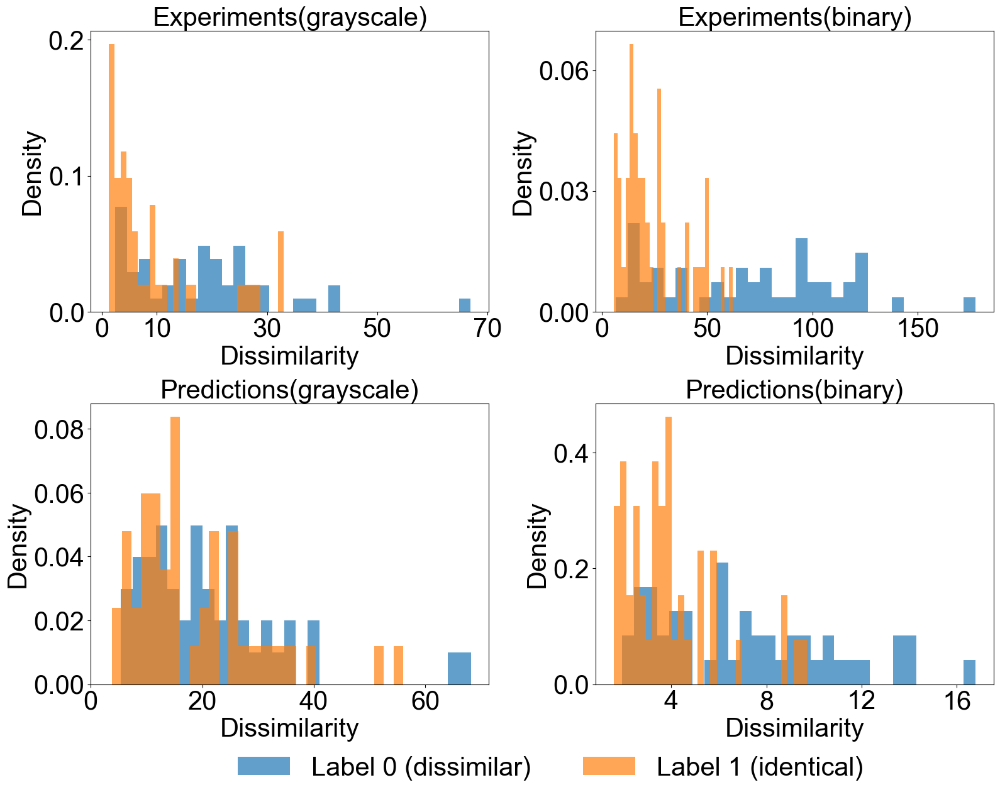

In [19]:
# Experiment in colors
scores_0a, scores_1a = get_scores_by_label(model, exp_loader_color, device)

# Experiment in binary
scores_0b, scores_1b = get_scores_by_label(model, exp_loader, device)

# Prediction in binary
scores_0c, scores_1c = get_scores_by_label(model, pred_loader, device)

# Prediction in color
scores_0d, scores_1d = get_scores_by_label(model, pred_loader_color, device)

titles= ["Experiments(grayscale)","Experiments(binary)","Predictions(grayscale)","Predictions(binary)"]

scores_0=[scores_0a,scores_0b,scores_0c,scores_0d]
scores_1=[scores_1a,scores_1b,scores_1c,scores_1d]

plot_score_histograms_subplots(scores_0, scores_1, titles, OUTPUT_DIR_CONTRASTIVE_LEARNING)

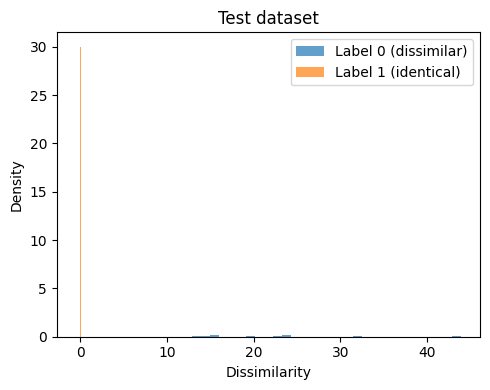

In [20]:
# Test set
scores_0, scores_1 = get_scores_by_label(model, test_loader, device)

# Plot
plot_score_histograms(scores_0, scores_1, "Test dataset", OUTPUT_DIR_CONTRASTIVE_LEARNING)


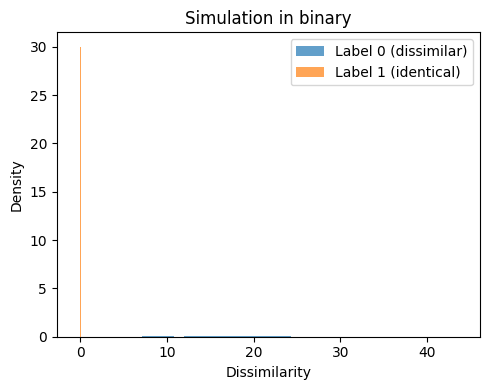

In [21]:
# Simulation set
scores_0, scores_1 = get_scores_by_label(model, sim_loader, device)


# Plot
plot_score_histograms(scores_0, scores_1, "Simulation in binary", OUTPUT_DIR_CONTRASTIVE_LEARNING)


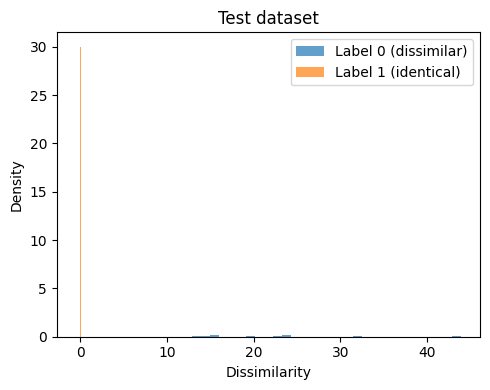

In [22]:
# Test set
scores_0, scores_1 = get_scores_by_label(model, test_loader, device)

# Plot
plot_score_histograms(scores_0, scores_1, "Test dataset", OUTPUT_DIR_CONTRASTIVE_LEARNING)


# Compare prediction-experiments vs simulation-experiments

In [23]:
# Generate image pairs, one from experiment, one from either prediction or simulation
class FixedPairDataset(Dataset):
    def __init__(self, exp_files, ref_files, transform=None, seed=42, image_size=(64, 64), preprocess_func_1=None, preprocess_func_2=None):
        self.transform = transform
        self.image_size = image_size
        self.pairs = []
        self.preprocess_func_1 = preprocess_func_1
        self.preprocess_func_2 = preprocess_func_2

        # Group references by ExpID
        ref_group = defaultdict(list)
        for f in ref_files:
            expid = os.path.basename(f).split('_')[0]
            ref_group[expid].append(f)

        random.seed(seed)

        for exp_f in exp_files:
            expid = os.path.basename(exp_f).split('_')[0]
            if expid in ref_group and len(ref_group[expid]) > 0:
                ref_f = random.choice(ref_group[expid])
            else:
                ref_f = None  # Use dummy data

            self.pairs.append((ref_f, exp_f))

    def __len__(self):
        return len(self.pairs)

    def __getitem__(self, idx):
        f1, f2 = self.pairs[idx]

        f1_name = os.path.basename(f1)

        if self.preprocess_func_2 is not None:
            img2 = self.preprocess_func_2(f2)
            img2= Image.fromarray(img2).convert("L")
            if self.preprocess_func_1 is not None:
                img1=self.preprocess_func_1(f1)
                img1= Image.fromarray(img1).convert("L")
            else:
                img1 = Image.open(f1).convert('L')
                
        else:
            img2 = Image.open(f2).convert('L')
            if self.preprocess_func_1 is not None:
                img1=self.preprocess_func_1(f1)
                img1= Image.fromarray(img1).convert("L")
            else:
                img1 = Image.open(f1).convert('L')      

       
        
           

      
        f1_name = os.path.basename(f1)

        if self.transform:
            img1 = self.transform(img1)
            img2 = self.transform(img2)

        return img1, img2, f1_name, os.path.basename(f2)


In [24]:
def compare_and_plot_by_index(model, sim_dataset, pred_dataset, device, output_dir, num_pairs=10):
    model.eval()
    sim_score_list = []
    pred_score_list = []

    print(f"Comparing up to {num_pairs} pairs (available: {len(sim_dataset)})")
    count = 0
    with torch.no_grad():
        for i in range(min(num_pairs, len(sim_dataset), len(pred_dataset))):
            img1_sim, img2_sim, name1_sim, name2_sim = sim_dataset[i]
            img1_pred, img2_pred, name1_pred, name2_pred = pred_dataset[i]

            # Skip mismatched experimental images (likely due to missing replicates)
            if name2_sim != name2_pred:
                print(f"[{i}] Skipping mismatched exp image: SIM = {name2_sim}, PRED = {name2_pred}")
                continue

            # Move to device
            img1_sim = img1_sim.unsqueeze(0).to(device)
            img2_sim = img2_sim.unsqueeze(0).to(device)
            img1_pred = img1_pred.unsqueeze(0).to(device)
            img2_pred = img2_pred.unsqueeze(0).to(device)

            # Compute distances
            out_sim1, out_sim2 = model(img1_sim, img2_sim)
            out_pred1, out_pred2 = model(img1_pred, img2_pred)

            d_sim = F.pairwise_distance(out_sim1, out_sim2).item()
            d_pred = F.pairwise_distance(out_pred1, out_pred2).item()
            if d_sim > d_pred: count += 1
            sim_score_list.append(d_sim)
            pred_score_list.append(d_pred)

            # Plot side by side
            fig, axs = plt.subplots(1, 3, figsize=(9, 3))

            axs[0].imshow(img1_sim.cpu().squeeze(), cmap='gray')
            axs[0].set_title(f"Sim vs Exp\nDissimilarity: {d_sim:.4f}\nref: {name1_sim}, exp: {name2_sim}")
            axs[0].axis('off')

            axs[1].imshow(img1_pred.cpu().squeeze(), cmap='gray')
            axs[1].set_title(f"Pred vs Exp\nDissimilarity: {d_pred:.4f}\nref: {name1_pred}, exp: {name2_pred}")
            axs[1].axis('off')

            axs[2].imshow(img2_pred.cpu().squeeze(), cmap='gray')
            axs[2].set_title(f"Exp: {name2_pred}")
            axs[2].axis('off')

            plt.suptitle(f"Experiment ID: {name2_sim.split('_')[0]}")
            plt.tight_layout()

            filename = os.path.join(output_dir, f"{i}_{name2_sim.replace('/', '_')}.png")
            plt.savefig(filename)

            plt.show()

    return sim_score_list, pred_score_list


Total exp images paired: 96 (sim), 96 (pred)
Comparing up to 96 pairs (available: 96)


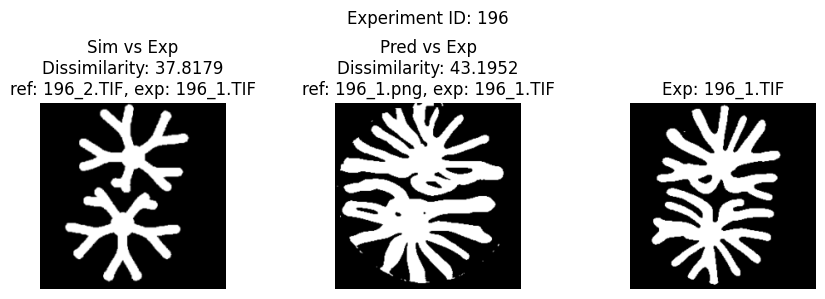

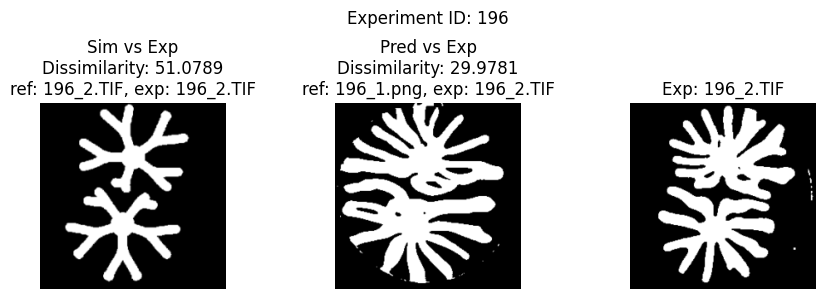

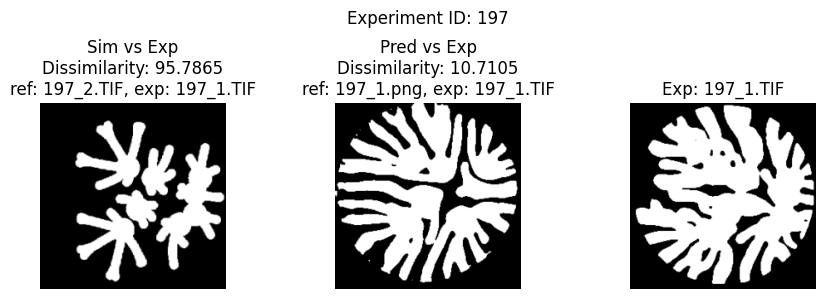

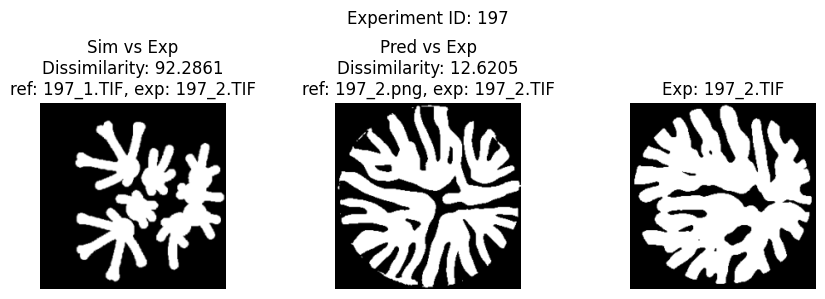

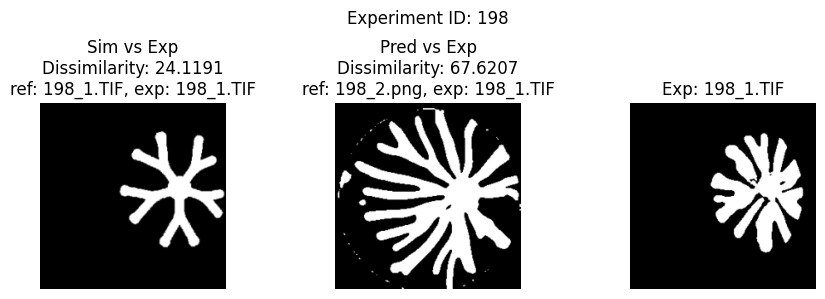

...

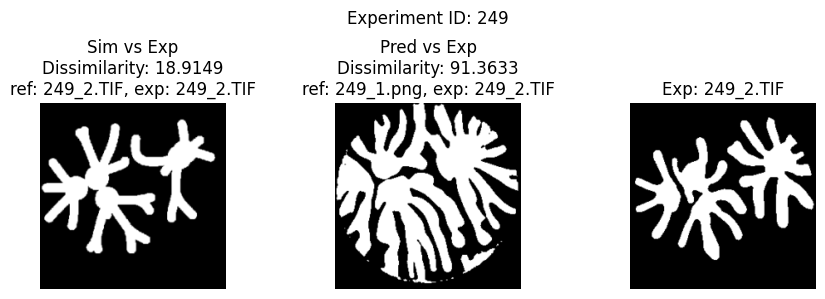

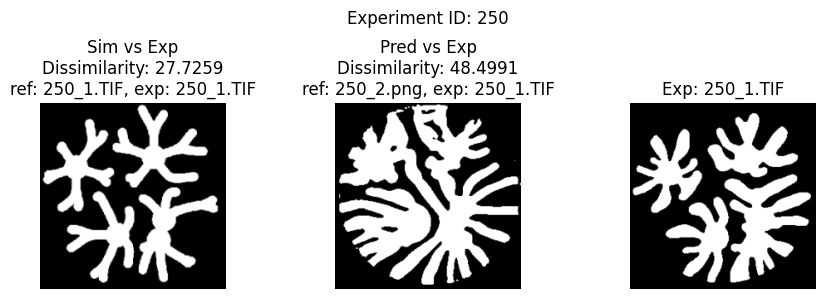

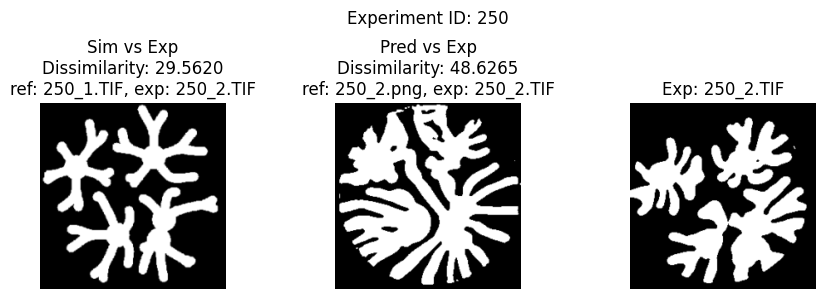

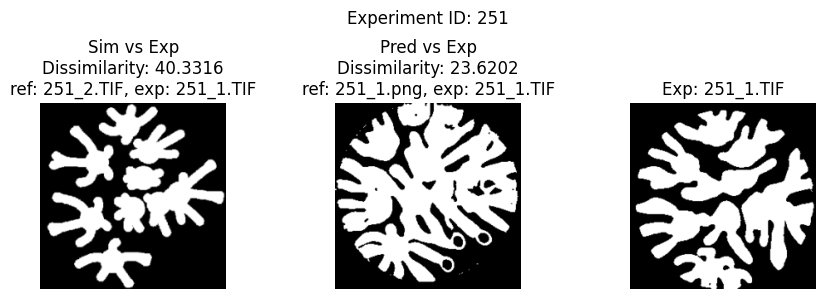

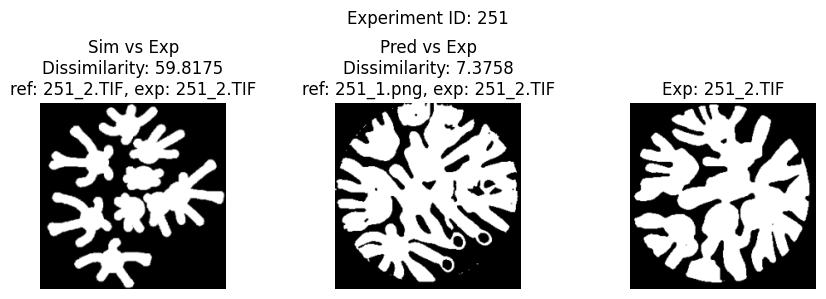

In [25]:
# Ensure sorting for consistent order
alldata_exp_sorted = sorted(alldata_exp)
# Generate sim-exp and pred-exp image pairs
sim_exp_dataset = FixedPairDataset(exp_files=alldata_exp_sorted, ref_files=alldata_sim, transform=transform, seed=42,preprocess_func_1=preprocess_simulation, preprocess_func_2=preprocess_experimental_backgroundblack_blackandwhite)
pred_exp_dataset = FixedPairDataset(exp_files=alldata_exp_sorted, ref_files=alldata_pred, transform=transform, seed=42, preprocess_func_1=preprocess_experimental_backgroundblack_blackandwhite_nocropping, preprocess_func_2=preprocess_experimental_backgroundblack_blackandwhite)

sim_exp_loader = DataLoader(sim_exp_dataset, batch_size=1, shuffle=False)
pred_exp_loader = DataLoader(pred_exp_dataset, batch_size=1, shuffle=False)

print(f"Total exp images paired: {len(sim_exp_loader)} (sim), {len(pred_exp_loader)} (pred)")
output_dir = f"{OUTPUT_DIR_CONTRASTIVE_LEARNING}/DissimilarityScore_Seeding/results/"
os.makedirs(output_dir, exist_ok=True)
# For each exp image, compare similarity with a simulation and a prediction image that are randomly pooled
sim_score_list, pred_score_list = compare_and_plot_by_index(model, sim_exp_dataset, pred_exp_dataset, device, output_dir, num_pairs=len(sim_exp_loader))


Simulations closer or approximately equal to experiments than predictions for : 64 out of 96


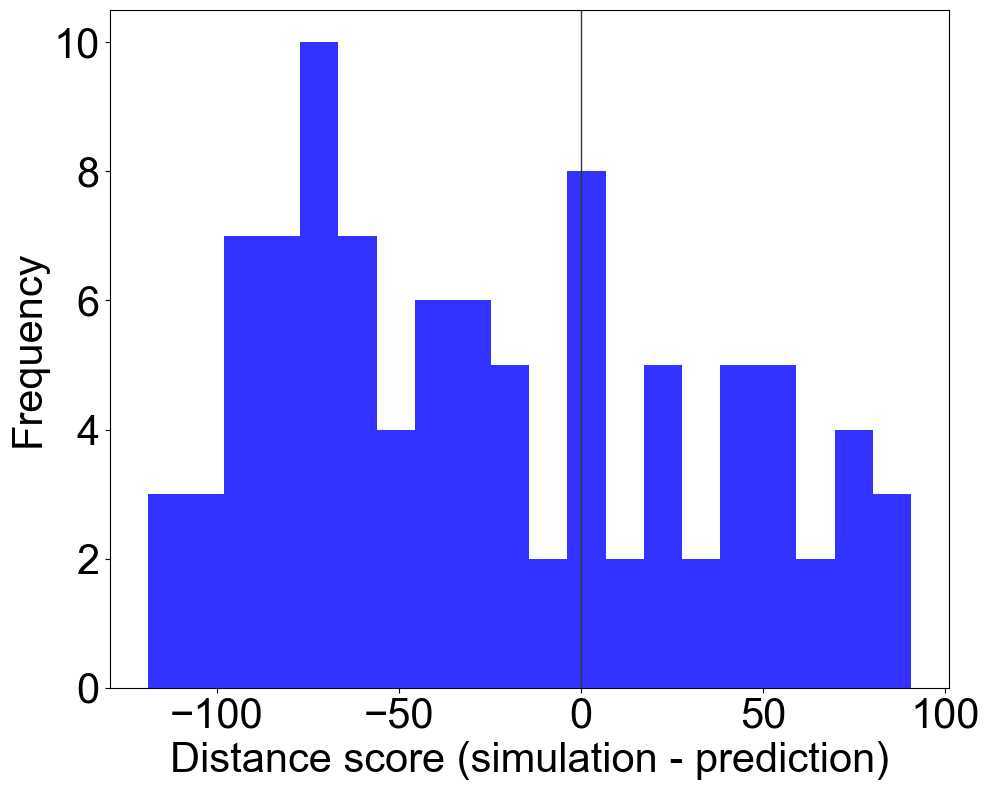

In [26]:
# Plot the histograms of distance differences
diff_list = [sim_score_list[i] - pred_score_list[i] for i in range(len(pred_score_list))]
count_sim_greater_or_close = sum(
    (sim < pred) or abs(sim - pred) < 0.05
    for sim, pred in zip(sim_score_list, pred_score_list)
)
print(f"Simulations closer or approximately equal to experiments than predictions for : {count_sim_greater_or_close} out of {len(sim_score_list)}")


plt.figure(figsize=(10,8))
plt.hist(diff_list, bins=20, color='blue', alpha=0.8)
plt.axvline(x=0, color=(0.2, 0.2, 0.2), linestyle='-', linewidth=1)
plt.xlabel("Distance score (simulation - prediction)",fontproperties=prop)
plt.ylabel("Frequency",fontproperties=prop)
plt.xticks(fontproperties=prop)
plt.yticks(fontproperties=prop)


plt.tight_layout()
# plt.xlim(-2,2)
filename=os.path.join(OUTPUT_DIR_CONTRASTIVE_LEARNING, "sim-pred_hist.png")
plt.savefig(filename)
plt.show()
